Checkpoint 1

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as mp

In [28]:
hiringdetails = pd.read_csv('C:/Users/gauravn/Desktop/Capstone4_HRData/HR_Hiring_details_transaction.csv')
domicile_master = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Domicile_Master.xlsx')
interviewdates = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Interview_dates.xlsx')
joiningstatus = pd.read_csv('C:/Users/gauravn/Desktop/Capstone4_HRData/Joining_Status.csv')
lobmaster = pd.read_csv('C:/Users/gauravn/Desktop/Capstone4_HRData/LOB_Master.csv')
locationmaster = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Location_Master.xlsx')
postalcodemaster = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Postal_Code_Master.xlsx')
regionlocationmapping = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Region_Location_Mapping.xlsx')
regionmaster = pd.read_excel('C:/Users/gauravn/Desktop/Capstone4_HRData/Region_Master.xlsx')

In [29]:
hiringdetails

,Sno,Candidate_Ref,DOJ_Extended,Duration_to_accept_offer,Notice_Period,Offered_Band,Percent_hike_expected_in_CTC,Percent_hike_offered_in_CTC,Percent_difference_CTC,Joining_Bonus,Candidate_relocate_actual,Gender,Candidate_Source,Rex_in_Yrs,Location_ID,Postal_Code,Age,LOB_Id,Domicile_Id
0,1,2110407,Yes,14,30,E2,-20.79,13.16,42.86,No,No,Female,Agency,7,L001,201301,34.0,1,D6
1,2,2112635,No,18,30,E2,50.00,320.00,180.00,No,No,Male,Employee Referral,8,L002,600020,34.0,2,D9
2,3,2112838,No,3,45,E2,42.84,42.84,0.00,No,No,Male,Agency,4,L001,201301,27.0,2,D10
3,4,2115021,No,26,30,E2,42.84,42.84,0.00,No,No,Male,Employee Referral,4,L001,201301,34.0,2,D3
4,5,2115125,Yes,1,120,E2,42.59,42.59,0.00,No,Yes,Male,Employee Referral,6,L001,201301,34.0,2,D21
5,6,2117167,Yes,17,30,E1,42.83,42.83,0.00,No,No,Male,Employee Referral,2,L001,201301,34.0,2,D24
6,7,2119124,Yes,37,30,E2,31.58,31.58,0.00,No,No,Male,Employee Referral,7,L001,201301,32.0,2,D23
7,9,2127572,Yes,16,0,E1,-20.00,-20.00,0.00,No,No,Female,Direct,8,L001,201301,34.0,3,D6
8,11,2138169,No,1,30,E1,-22.22,-22.22,0.00,No,No,Female,Employee Referral,3,L003,122107,26.0,4,D5
9,12,2143362,No,6,30,E1,240.00,220.00,-5.88,No,No,Male,Employee Referral,3,L002,600020,34.0,5,D23


In [25]:
hiringdetails.isna().sum()

Sno                              0
Candidate_Ref                    0
DOJ_Extended                     0
Duration_to_accept_offer         0
Notice_Period                    0
Offered_Band                    13
Percent_hike_expected_in_CTC     0
Percent_hike_offered_in_CTC      0
Percent_difference_CTC           0
Joining_Bonus                    0
Candidate_relocate_actual        0
Gender                           0
Candidate_Source                 0
Rex_in_Yrs                       0
Location_ID                      0
Postal_Code                      0
Age                             15
LOB_Id                           0
Domicile_Id                      0
dtype: int64

In [30]:
hiringdetails['Offered_Band'].fillna('E1',inplace = True)

In [31]:
hiringdetails['Age'].fillna(34.0,inplace=True)

In [32]:
hiringdetails=pd.merge(hiringdetails,joiningstatus,on='Candidate_Ref',how='right')

In [33]:
hiringdetails.isna().sum()

Sno                             0
Candidate_Ref                   0
DOJ_Extended                    0
Duration_to_accept_offer        0
Notice_Period                   0
Offered_Band                    0
Percent_hike_expected_in_CTC    0
Percent_hike_offered_in_CTC     0
Percent_difference_CTC          0
Joining_Bonus                   0
Candidate_relocate_actual       0
Gender                          0
Candidate_Source                0
Rex_in_Yrs                      0
Location_ID                     0
Postal_Code                     0
Age                             0
LOB_Id                          0
Domicile_Id                     0
Status                          0
dtype: int64

Q1. Analysis of Percentage of Joined 


INFERENCE: Percentage of Candidats joining the company is 81.3% of the toal Candidates. There are a few among the total candidates which account for 20% who did not join the company.

In [43]:
percentage = hiringdetails['Status'][hiringdetails['Status'] == 'Joined'].count()
analysis_percentage = (percentage/8995)*100
analysis_percentage

81.30072262367982

Q.3.  Are there any specific locations where candidates are not joining

In [44]:
location_df = pd.merge(hiringdetails,locationmaster, on = 'Location_ID', how = 'right')
'''location_df['Status'].mask(location_df['Status'] == 'Joined',1,inplace=True)
location_df['Status'].mask(location_df['Status'] == 'Not Joined',0,inplace=True)
'''
location_df

,Sno,Candidate_Ref,DOJ_Extended,Duration_to_accept_offer,Notice_Period,Offered_Band,Percent_hike_expected_in_CTC,Percent_hike_offered_in_CTC,Percent_difference_CTC,Joining_Bonus,...,Gender,Candidate_Source,Rex_in_Yrs,Location_ID,Postal_Code,Age,LOB_Id,Domicile_Id,Status,Location
0,1,2110407,Yes,14,30,E2,-20.79,13.16,42.86,No,...,Female,Agency,7,L001,201301,34.0,1,D6,Joined,Noida
1,3,2112838,No,3,45,E2,42.84,42.84,0.00,No,...,Male,Agency,4,L001,201301,27.0,2,D10,Joined,Noida
2,4,2115021,No,26,30,E2,42.84,42.84,0.00,No,...,Male,Employee Referral,4,L001,201301,34.0,2,D3,Joined,Noida
3,5,2115125,Yes,1,120,E2,42.59,42.59,0.00,No,...,Male,Employee Referral,6,L001,201301,34.0,2,D21,Joined,Noida
4,6,2117167,Yes,17,30,E1,42.83,42.83,0.00,No,...,Male,Employee Referral,2,L001,201301,34.0,2,D24,Joined,Noida
5,7,2119124,Yes,37,30,E2,31.58,31.58,0.00,No,...,Male,Employee Referral,7,L001,201301,32.0,2,D23,Joined,Noida
6,9,2127572,Yes,16,0,E1,-20.00,-20.00,0.00,No,...,Female,Direct,8,L001,201301,34.0,3,D6,Joined,Noida
7,13,2151180,No,120,30,E2,5.26,-60.53,-62.50,No,...,Male,Employee Referral,3,L001,201301,34.0,2,D6,Not Joined,Noida
8,15,2156236,Yes,14,30,E2,50.00,287.50,158.33,No,...,Male,Agency,7,L001,201301,29.0,2,D13,Not Joined,Noida
9,16,2158703,No,44,75,E2,45.45,60.00,10.00,No,...,Male,Direct,8,L001,201301,34.0,2,D13,Not Joined,Noida


In [37]:
for x in location_df.index:
    location_df['Percent_difference_CTC'] = location_df['Percent_hike_expected_in_CTC'] - location_df['Percent_hike_offered_in_CTC']


Locations Where Candidates are not Joining

In [45]:
'''location_df[['Location','Status']][location_df['Status'] == 'Not Joined']'''
newdf = location_df[['Location_ID','Location','Status']]

new = newdf[['Location','Status']][newdf['Status'] == 'Not Joined']
new1 = pd.DataFrame(new.groupby(['Location','Status']))
new1

,0,1
0,"(Ahmedabad, Not Joined)",Location Status 8981 Ahmedabad N...
1,"(Bangalore, Not Joined)",Location Status 6027 Bangalore N...
2,"(Chennai, Not Joined)",Location Status 2733 Chennai Not J...
3,"(Cochin, Not Joined)",Location Status 8723 Cochin Not J...
4,"(Gurgaon, Not Joined)",Location Status 5890 Gurgaon Not J...
5,"(Hyderabad, Not Joined)",Location Status 8253 Hyderabad N...
6,"(Kolkata, Not Joined)",Location Status 8596 Kolkata Not J...
7,"(Mumbai, Not Joined)",Location Status 8791 Mumbai Not J...
8,"(Noida, Not Joined)",Location Status 7 Noida Not J...
9,"(Pune, Not Joined)",Location Status 8731 Pune Not J...


    Q.4.  Joining status depends on the duration to accept an offer?

In [50]:
hr=hiringdetails[['Duration_to_accept_offer','Status']]

#hr['Duration_to_accept_offer'].mask(hr['Duration_to_accept_offer'] == 0,hr['Duration_to_accept_offer'].median(),inplace=True)
hr['Status']=hr['Status'].map({'Joined':1,'Not Joined':0})
'''hr['Status'].mask(hr['Status'] == 'Joined',1,inplace=True)
hr['Status'].mask(hr['Status'] == 'Not Joined',0,inplace=True)
'''
hr

C:\Users\gauravn\AppData\Local\Temp/ipykernel_18672/3192129253.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hr['Status']=hr['Status'].map({'Joined':1,'Not Joined':0})


,Duration_to_accept_offer,Status
0,14,1
1,18,1
2,3,1
3,26,1
4,1,1
5,17,1
6,37,1
7,16,1
8,1,1
9,6,1


<AxesSubplot:xlabel='Duration_to_accept_offer', ylabel='Status'>

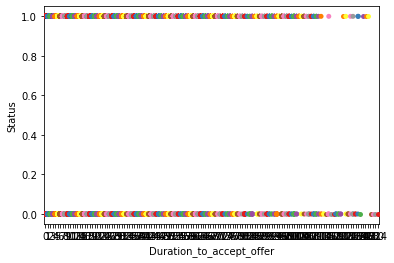

In [52]:
sns.stripplot(data=hr,x='Duration_to_accept_offer',y='Status',palette='Set1')

INFERENCE: Joining status does not depend on the Duration to accept the offer as there is no correlation between the two.

In [ ]:
from scipy.stats import chi2_contingency
stat,p_value,dof,expected = chi2_contingency(hr)
alpha = 0.05
if p_value <= alpha:
    print('Dependent (Reject H0)')
else:
    print('Independent (accept H0)')

In [ ]:
sns.scatterplot(data=hr)

In [ ]:
mp.scatter(x=hr['Status'],y=hr['Duration_to_accept_offer'])
mp.xlabel='Status Of joining'
mp.ylabel = 'Duration to accept the offer'
mp.show()
p=sns.jointplot(hr['Status'],hr['Duration_to_accept_offer'],height = 6)

Q.5. Hike offered has an impact on joining status.?



In [ ]:
impactdf = location_df[['Percent_hike_offered_in_CTC','Status']]
impactdf

In [ ]:
from scipy.stats import chi2_contingency
stat,p_value,dof,expected = chi2_contingency(impactdf)
alpha = 0.05
if p_value <= alpha:
    print('Dependent (Reject H0)')
else:
    print('Independent (accept H0)')

In [ ]:
'''mp.scatter(y=impactdf['Percent_hike_offered_in_CTC'],x=impactdf['Status'])
mp.show()
'''
mp.bar(impactdf['Status'],impactdf['Percent_hike_offered_in_CTC'])
mp.show()
np.cov(impactdf)

In [ ]:
'''list1=[impactdf['Percent_hike_offered_in_CTC']]
list2 = [impactdf['Status']]
for i in range(len(list2)):
    if list2[i] == 'Joined':
        impactdf['Status'][i] = 1
    else:
        impactdf['Status'][i] = 0'''

In [ ]:
for x in impactdf['Status'].index:
    if impactdf['Status'][x] == 'Joined':
        impactdf['Status'][x] = 1
    else:
        impactdf['Status'][x] = 0
impactdf

In [ ]:
np.cov(impactdf)

In [ ]:
location_df

TASK 1.3 STATISTICAL ANALYSIS USING PYTHON

In [ ]:
print(location_df.describe(include='all'))

In [ ]:
print(location_df.info())

In [ ]:
sns.pairplot(location_df)

1.1.3 STATISTICAL ANALYSIS USING PYTHON

In [ ]:
location_df

In [ ]:
location_df.describe()

Inference:
    
    The percent hike expected and percent hike offered has an impact on the joining status. There is a positive corrleation. 
        the points lie around its mean. There are more no of joined when the expectation and the offered hike percentage is     sufficing their requirement.
        
        The candidates are mostly from the age group of 29.
        
        

In [ ]:
print(location_df.median())
print(location_df.mode())

In [ ]:
sns.scatterplot(data=location_df,x='Percent_hike_expected_in_CTC',y='Percent_hike_offered_in_CTC',hue='Status',estimator=np.std)

In [ ]:
sph1 = location_df[['Percent_hike_expected_in_CTC','Percent_hike_offered_in_CTC','Status']]
sph=abs(sph1[['Percent_hike_expected_in_CTC','Percent_hike_offered_in_CTC']])
#sph['Percent_hike_expected_in_CTC'] = sph['Percent_hike_expected_in_CTC'].map({0:0.1})
for x in sph.index:
    if sph['Percent_hike_expected_in_CTC'][x] == 0 or sph['Percent_hike_offered_in_CTC'][x] == 0:
        sph['Percent_hike_expected_in_CTC'][x] = 0.1
        sph['Percent_hike_offered_in_CTC'][x] = 0.1
sph

H0: Percentage of hike offered and hike expected has an impact
H1: Percentage of hike offered and hike expected does not have an impact

In [ ]:
sph1

In [ ]:
def chifunc(datas):
    from scipy.stats import chi2_contingency
    stat,p_value,dof,expected = chi2_contingency(datas)
    alpha = 0.05
    print(p_value)
    if p_value <= alpha:
        print('Reject H0: there is an impact')
    else:
        print("Accept H0: There isn't any impact")